## Notebookの下準備

In [1]:
# black formatterの設定
import jupyter_black

jupyter_black.load()

## ライブラリのimport

In [2]:
# Entropic GMM-OT(EGOT) ver5

from itertools import permutations
import pickle
import shelve
import numpy as np
import pandas as pd
import scipy.linalg as spl
import scipy.stats
import scipy.stats as sps
import sklearn
import sklearn.mixture
import matplotlib
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap.umap_ as umap
import time

# import os
import glob
import csv
import screcode
from scipy.stats import multivariate_normal
import seaborn as sns

sns.set_style("whitegrid")
from natsort import natsorted
import ot

# import ot.plot
import matplotlib.animation as animation
from PIL import Image
from matplotlib.animation import PillowWriter
import itertools
import networkx as nx
import plotly.express as px
import plotly.graph_objects as go
from sklearn.utils import check_random_state
from IPython.display import HTML
from IPython.display import Image
import warnings

warnings.filterwarnings("ignore")
from scipy import interpolate
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from sklearn import linear_model
import pydotplus
from sklearn.neighbors import kneighbors_graph
from scipy import sparse

import os

## 関数定義

In [3]:
# モジュール群
# 後でまとめるため， とりあえず作ったモジュールはここに追加していく


def df_screcode(df):
    X_recode = screcode.RECODE().fit_transform(df.values)
    df_screcode = pd.DataFrame(X_recode, index=df.index, columns=df.columns)
    return df_screcode


def print_all_files(all_files):
    for file in all_files:
        print(file)


def df_concat_all_files(all_files):
    df = pd.read_csv(all_files[0], index_col=0)
    for i in range(1, len(all_files)):
        df1 = pd.read_csv(all_files[i], index_col=0)
        df = pd.concat([df, df1], axis=0, join="inner")
    return df


def df_concat_all_files_screcode(all_files):
    df = pd.read_csv(all_files[0], index_col=0)
    X_recode = screcode.RECODE().fit_transform(df.values)
    df_screcode = pd.DataFrame(X_recode, index=df.index, columns=df.columns)
    for i in range(1, len(all_files)):
        df1 = pd.read_csv(all_files[i], index_col=0)
        X1_screcode = screcode.RECODE().fit_transform(df1.values)
        df1_screcode = pd.DataFrame(X1_screcode, index=df1.index, columns=df1.columns)
        df_screcode = pd.concat([df_screcode, df1_screcode], axis=0, join="inner")
    return df_screcode


def compute_cell_numbers(all_files):
    cell_numbers = []
    for i in range(len(all_files)):
        df = pd.read_csv(all_files[i], index_col=0)
        cell_numbers.append(len(df.index))
    return cell_numbers


def df_print_datainfo(df):
    genes = df.columns
    cells = df.index
    print(len(genes), "genes,", len(cells), "cells")
    nreads = df.values.sum(axis=1)
    ngenes = (df.values > 0.0).astype(int).sum(axis=1)
    print(
        "Assigned reads: max=",
        np.max(nreads),
        "min=",
        np.min(nreads),
        "average={:.2f}".format(np.average(nreads)),
    )
    print(
        "Detected genes: max=",
        np.max(ngenes),
        "min=",
        np.min(ngenes),
        "average={:.2f}".format(np.average(ngenes)),
    )


def df_UMInormalized(df, UMI_norm=100000):
    df = df.div(df.sum(axis=1), axis=0) * UMI_norm
    return df


def df_delete_MTgenes(df):
    df.drop(df.columns[df.columns.str.startswith("MT-")], axis=1, inplace=True)
    return df


def df_log2normalized(df):
    df = df.where(df > 0, 0)
    # log_values = np.log(df.values + 1)
    log_values = np.log1p(df.values)
    df_log = pd.DataFrame(log_values, index=df.index, columns=df.columns)
    return df_log


def df_PCA(df, n_components):
    pca = PCA(n_components=n_components)
    pca.fit(df.values)
    Xpca = pca.transform(df.values)
    df_pca = pd.DataFrame(
        Xpca,
        index=df.index,
        columns=["PC{}".format(x + 1) for x in range(n_components)],
    )
    print("sum of explained_variance_ratio =", sum(pca.explained_variance_ratio_ * 100))
    return df_pca


def savefile_all_to_each_day(df, cell_numbers, savedir, filename):
    to_cell_numbers = cell_numbers[0]
    df_temp = df.iloc[:to_cell_numbers, :]
    df_temp.to_csv("%s/%s.csv" % (savedir, filename[0]))
    from_cell_numbers = cell_numbers[0]
    for i in range(1, len(cell_numbers)):
        to_cell_numbers = from_cell_numbers + cell_numbers[i]
        df_temp = df.iloc[from_cell_numbers:to_cell_numbers, :]
        df_temp.to_csv("%s/%s.csv" % (savedir, filename[i]))
        from_cell_numbers += cell_numbers[i]


def densite_theorique2d(mu, Sigma, alpha, x):
    K = mu.shape[0]
    alpha = alpha.reshape(1, K)
    y = 0
    for j in range(K):
        y += alpha[0, j] * sps.multivariate_normal.pdf(
            x, mean=mu[j, :], cov=Sigma[j, :, :]
        )
    return y


def plot_PCA(df_PCA, X):
    plt.scatter(X.values[:, 0], X.values[:, 1], s=0.5, alpha=0.8)
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.xlim(np.min(df_PCA["PC1"].values) - 5, np.max(df_PCA["PC1"].values) + 5)
    plt.ylim(np.min(df_PCA["PC2"].values) - 5, np.max(df_PCA["PC2"].values) + 5)


def plot_UMAP(df_UMAP, X):
    plt.scatter(X.values[:, 0], X.values[:, 1], s=0.5, alpha=0.8)
    plt.xlabel("UMAP1")
    plt.ylabel("UMAP2")
    plt.xlim(np.min(df_UMAP["UMAP1"].values) - 1, np.max(df_UMAP["UMAP1"].values) + 1)
    plt.ylim(np.min(df_UMAP["UMAP2"].values) - 1, np.max(df_UMAP["UMAP2"].values) + 1)


def plot_GMM(df_PCA, X, labels, n_components):
    plt.scatter(
        X.values[:, 0],
        X.values[:, 1],
        c=labels,
        cmap=plt.cm.get_cmap("cubehelix", n_components),
        edgecolor="gray",
    )
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.xlim(np.min(df_PCA["PC1"].values) - 5, np.max(df_PCA["PC1"].values) + 5)
    plt.ylim(np.min(df_PCA["PC2"].values) - 5, np.max(df_PCA["PC2"].values) + 5)
    plt.colorbar(ticks=range(n_components), label="cluster")
    plt.clim(-0.5, n_components - 0.5)


def plot_GMM_UMAP(df_UMAP, X, labels, n_components):
    plt.scatter(
        X.values[:, 0],
        X.values[:, 1],
        c=labels,
        cmap=plt.cm.get_cmap("cubehelix", n_components),
        edgecolor="gray",
    )
    plt.xlabel("UMAP1")
    plt.ylabel("UMAP2")
    plt.xlim(np.min(df_UMAP["UMAP1"].values) - 1, np.max(df_UMAP["UMAP1"].values) + 1)
    plt.ylim(np.min(df_UMAP["UMAP2"].values) - 1, np.max(df_UMAP["UMAP2"].values) + 1)
    plt.colorbar(ticks=range(n_components), label="cluster")
    plt.clim(-0.5, n_components - 0.5)


def GaussianW(m0, m1, Sigma0, Sigma1):
    Sigma00 = spl.sqrtm(Sigma0)
    Sigma010 = spl.sqrtm(Sigma00 @ Sigma1 @ Sigma00)
    d = np.linalg.norm(m0 - m1) ** 2 + np.trace(Sigma0 + Sigma1 - 2 * Sigma010)
    return dpy


def GaussianMap(m0, m1, Sigma0, Sigma1, x):
    d = Sigma0.shape[0]
    m0 = m0.reshape(1, d)
    m1 = m1.reshape(1, d)
    Sigma0 = Sigma0.reshape(d, d)
    Sigma1 = Sigma1.reshape(d, d)
    Sigma = np.linalg.pinv(Sigma0) @ spl.sqrtm(Sigma0 @ Sigma1)
    Tx = m1 + (x - m0) @ Sigma
    return Tx


# def sinkhorn(pi0,pi1,M,epsilon,itermax,threshold):
#    n_source = len(pi0)
#    n_target = len(pi1)
#    a = np.ones((n_source,))
#    b = np.ones((n_target,))

# Sinkhorn's algorithm
#    v = np.ones(n_target)
#    epsilon = epsilon
#    K = np.exp(-M/epsilon)
#    threshold = threshold
#    u = a / (np.dot(K,v))
#    itermax = itermax
#    for i in range(itermax):
#        if np.linalg.norm(u - a / np.dot(K,v),ord=1) + np.linalg.norm(v - b / (np.dot(np.transpose(K),u)),ord=1) < threshold:
# print('break at '+str(i))
#            break
#        u = a / (np.dot(K,v))
#        v = b / (np.dot(np.transpose(K),u))
#    P = np.dot(np.dot(np.diag(u),K),np.diag(v))
#    return P


def EGW(pi0, pi1, mu0, mu1, S0, S1):
    K0 = mu0.shape[0]
    K1 = mu1.shape[0]
    d = mu0.shape[1]
    S0 = S0.reshape(K0, d, d)
    S1 = S1.reshape(K1, d, d)
    M = np.zeros((K0, K1))
    for k in range(K0):
        for l in range(K1):
            M[k, l] = GaussianW(mu0[k, :], mu1[l, :], S0[k, :, :], S1[l, :, :])
    wstar = ot.sinkhorn(
        pi0,
        pi1,
        M / M.max(),
        0.01,
        method="sinkhorn_epsilon_scaling",
        numItermax=10000000000,
        tau=1e8,
        stopThr=1e-9,
    )
    return wstar


def interpolation_contour(df_PCA, t):
    pit = wstar.reshape(K0 * K1, 1).T
    mut = np.zeros((K0 * K1, d))
    St = np.zeros((K0 * K1, d, d))
    for k in range(K0):
        for l in range(K1):
            mut[k * K1 + l, :] = (1 - t) * mu0[k, :] + t * mu1[l, :]
            Sigma1demi = spl.sqrtm(S1[l, :, :])
            C = (
                Sigma1demi
                @ spl.inv(spl.sqrtm(Sigma1demi @ S0[k, :, :] @ Sigma1demi))
                @ Sigma1demi
            )
            St[k * K1 + l, :, :] = (
                ((1 - t) * np.eye(d) + t * C)
                @ S0[k, :, :]
                @ ((1 - t) * np.eye(d) + t * C)
            )

    x = np.linspace(
        np.min(df_PCA["PC1"].values) - 5, np.max(df_PCA["PC1"].values) + 5, 1000
    )
    y = np.linspace(
        np.min(df_PCA["PC2"].values) - 5, np.max(df_PCA["PC2"].values) + 5, 1000
    )
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = densite_theorique2d(mut[:, 0:2], St[:, 0:2, 0:2], pit, XX)
    Z = Z.reshape(X.shape)
    maxZ = np.max(Z)
    minZ = np.min(Z)
    img = plt.contour(X, Y, Z, np.linspace(minZ - 1e-9, maxZ, 20), cmap="rainbow")
    return img.collections


def list_cluster_all(all_files, file_name, cluster_numbers):
    cluster_all = []
    cluster_temp = []
    all_days = len(all_files)
    for day in range(all_days):
        n_components1 = cluster_numbers[day]
        t = range(n_components1)
        for n2 in t:
            cluster_temp.append(f"d{file_name[day]}-c{n2}")
        cluster_all.append(cluster_temp)
        cluster_temp = []
    return cluster_all


def df_makegraph(all_files, cluster_all, wstar_all, Thr=0.05):
    all_days = len(all_files)
    product = []
    result = []
    for day in range(all_days - 1):
        test2 = {"source": cluster_all[day], "target": cluster_all[day + 1]}
        product = product + [
            x for x in itertools.product(cluster_all[day], cluster_all[day + 1])
        ]
    result = result + [dict(zip(test2.keys(), r)) for r in product]
    df_graph = pd.DataFrame(result)

    temp = itertools.chain.from_iterable(list(itertools.chain.from_iterable(wstar_all)))
    df_graph["edge_weights"] = list(temp)

    df_graph = df_graph[df_graph["edge_weights"] > Thr]
    return df_graph


def df_makenodeweights_and_pos(node_weights, cluster_all, xpos, ypos, node_day):
    df_nodeweights_and_pos = pd.DataFrame(
        node_weights, index=cluster_all, columns=["node_weights"]
    )
    df_nodeweights_and_pos["xpos"] = xpos
    df_nodeweights_and_pos["ypos"] = ypos
    df_nodeweights_and_pos["node_days"] = node_day
    return df_nodeweights_and_pos


def get_genes_nlargest(series, num=10):
    nlargest = series.nlargest(num)
    return nlargest.index


def get_genes_nsmallest(series, num=10):
    nsmallest = series.nsmallest(num)
    return nsmallest.index


def df_fold_change(df_genes, cluster1, cluster2):
    gene_exp1 = df_genes.T[cluster1]
    gene_exp2 = df_genes.T[cluster2]
    FC = gene_exp2 - gene_exp1
    df_FC = pd.DataFrame(index=FC.index)
    df_FC["FC"] = FC.values
    df_FC_sort = df_FC.sort_values(by=["FC"], ascending=False)
    return df_FC_sort


def plot_fold_change(df_genes, cluster1, cluster2, threshold=1.0):
    df_genes_FC = pd.DataFrame(index=df_genes.T.index)
    df_genes_FC[cluster1] = df_genes.T[cluster1]
    df_genes_FC[cluster2] = df_genes.T[cluster2]

    fig = go.Figure()
    gene_exp1 = df_genes_FC[cluster1]
    gene_exp2 = df_genes_FC[cluster2]
    absFC = (gene_exp2 - gene_exp1).abs()
    df_genes_FC2 = df_genes_FC.loc[
        df_genes_FC.index.isin(absFC[absFC.values > threshold].index), :
    ]
    text1 = df_genes.T.index
    text2 = df_genes_FC2.index

    fig.add_trace(
        go.Scatter(
            x=df_genes.T[cluster1],
            y=df_genes.T[cluster2],
            mode="markers",
            marker={
                "symbol": "circle",
                "color": "blue",
                "opacity": 0.1,
            },
            text=text1,
            name=f"|FC| < {threshold}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_genes_FC2[cluster1],
            y=df_genes_FC2[cluster2],
            mode="markers+text",
            marker={
                "symbol": "circle",
                "color": "red",
                "opacity": 0.8,
            },
            text=text2,
            textposition="top center",
            name=f"|FC| > {threshold}",
        )
    )

    fig.update_layout(
        xaxis={"title": cluster1},
        yaxis={"title": cluster2},
        width=1000,
        height=800,
        showlegend=True,
        title=f"Fold Change (threshold = {threshold})",
    )
    fig.show()


def df_up_regulated_genes(df_genes, df_graph, num=10):
    source_name = df_graph["source"]
    target_name = df_graph["target"]
    sum_name = source_name + target_name
    df_upgenes = pd.DataFrame([])
    for i in range(len(sum_name)):
        s1 = source_name.values[i]
        s2 = target_name.values[i]
        df_FC = df_fold_change(df_genes, s1, s2)
        upgenes = df_FC.apply(get_genes_nlargest, num=num)
        df_upgenes = df_upgenes.append(upgenes["FC"], ignore_index=True)
    df_upgenes = pd.DataFrame(
        df_upgenes.values, index=sum_name, columns=df_upgenes.columns
    )
    df_upgenes.columns += 1
    return df_upgenes


def df_down_regulated_genes(df_genes, df_graph, num=10):
    source_name = df_graph["source"]
    target_name = df_graph["target"]
    sum_name = source_name + target_name
    df_downgenes = pd.DataFrame([])
    for i in range(len(sum_name)):
        s1 = source_name.values[i]
        s2 = target_name.values[i]
        df_FC = df_fold_change(df_genes, s1, s2)
        downgenes = df_FC.apply(get_genes_nsmallest, num=num)
        df_downgenes = df_downgenes.append(downgenes["FC"], ignore_index=True)
    df_downgenes = pd.DataFrame(
        df_downgenes.values, index=sum_name, columns=df_downgenes.columns
    )
    df_downgenes.columns += 1
    return df_downgenes


def cell_state_graph(
    G,
    pos,
    df_node_up_gene_sets,
    df_node_down_gene_sets,
    df_edge_up_gene_sets,
    df_edge_down_gene_sets,
):
    tail_list = []
    head_list = []
    trace_recode = []
    text_node_up_gene_sets = df_node_up_gene_sets.values
    text_node_down_gene_sets = df_node_down_gene_sets.values

    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        tail_list.append(pos[edge[0]])
        head_list.append(pos[edge[1]])
        weight = G.edges[edge]["edge_weights"] * 25

        edge_trace = go.Scatter(
            x=tuple([x0, x1, None]),
            y=tuple([y0, y1, None]),
            mode="lines",
            line={"width": weight},
            line_color="slateblue",
            line_shape="spline",
            opacity=0.4,
        )

        trace_recode.append(edge_trace)

    middle_hover_trace = go.Scatter(
        x=[],
        y=[],
        hovertext=[],
        mode="markers",
        textposition="top center",
        hoverinfo="text",
        marker={"size": 20, "color": "slateblue"},
        opacity=0,
    )

    for edge in G.edges:
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        from_to = str(edge[0]) + str(edge[1])
        hovertext1 = df_edge_up_gene_sets.T[from_to].values
        hovertext2 = df_edge_down_gene_sets.T[from_to].values
        hovertext = "up_gene: " + hovertext1 + " " + "down_gene: " + hovertext2 + "<br>"
        middle_hover_trace["x"] += tuple([(x0 + x1) / 2])
        middle_hover_trace["y"] += tuple([(y0 + y1) / 2])
        middle_hover_trace["hovertext"] += tuple([hovertext])
        trace_recode.append(middle_hover_trace)

    head_trace = [
        go.Scatter(x=[head[0]], y=[head[1]], mode="lines+markers") for head in head_list
    ]

    tail_trace = [
        go.Scatter(x=[tail[0]], y=[tail[1]], mode="markers") for tail in tail_list
    ]

    arrows = [
        go.layout.Annotation(
            dict(
                x=head[0],
                y=head[1],
                showarrow=True,
                xref="x",
                yref="y",
                arrowcolor="slateblue",
                arrowsize=2,
                arrowwidth=2,
                ax=tail[0],
                ay=tail[1],
                axref="x",
                ayref="y",
                arrowhead=1,
            )
        )
        for head, tail in zip(head_list, tail_list)
    ]

    arrow_trace = head_trace + tail_trace

    node_x = []
    node_y = []
    node_hover_trace = go.Scatter(
        x=[],
        y=[],
        hovertext=[],
        mode="markers",
        textposition="top center",
        hoverinfo="text",
        marker={"size": 20, "color": [w["day"] for w in G.nodes.values()]},
        opacity=0,
    )

    for node in G.nodes():
        x, y = pos[node]
        node_x.append(x)
        node_y.append(y)
        hovertext1 = df_node_up_gene_sets.T[node].values
        hovertext2 = df_node_down_gene_sets.T[node].values
        hovertext = (
            "largest_gene: "
            + hovertext1
            + " "
            + "smallest_gene: "
            + hovertext2
            + "<br>"
        )
        node_hover_trace["x"] += tuple([x])
        node_hover_trace["y"] += tuple([y])
        node_hover_trace["hovertext"] += tuple([hovertext])
        trace_recode.append(node_hover_trace)

    node_trace = go.Scatter(
        x=node_x,
        y=node_y,
        text=list(G.nodes()),
        textposition="top center",
        mode="markers+text",
        hoverinfo="text",
        marker=dict(line_width=2),
    )

    node_trace.marker.color = [w["day"] for w in G.nodes.values()]
    node_trace.marker.size = [w["weight"] * 140 for w in G.nodes.values()]
    trace_recode.append(node_trace)

    fig = go.Figure(
        data=trace_recode, layout=go.Layout(showlegend=False, hovermode="closest")
    )

    fig.update_layout(annotations=arrows)

    fig.update_layout(width=1000, height=800, title="Cell state graph")
    fig.show()


def plot_pathway_mean_var(df_pathway_genes, threshold=1.0):
    mean = df_pathway_genes.mean(axis=0)
    var = df_pathway_genes.var(axis=0)
    df_pathway_mean_var = pd.DataFrame(
        mean, index=df_pathway_genes.columns, columns=["mean"]
    )
    df_pathway_mean_var["var"] = var

    fig = go.Figure()
    df_pathway_mean_var2 = df_pathway_mean_var.loc[
        df_pathway_mean_var.index.isin(
            df_pathway_mean_var[df_pathway_mean_var["var"].values > threshold].index
        ),
        :,
    ]
    text1 = df_pathway_mean_var.index
    text2 = df_pathway_mean_var2.index

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_var["mean"],
            y=df_pathway_mean_var["var"],
            mode="markers",
            marker={
                "symbol": "circle",
                "color": "blue",
                "opacity": 0.1,
            },
            text=text1,
            name=f"var < {threshold}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_var2["mean"],
            y=df_pathway_mean_var2["var"],
            mode="markers+text",
            marker={
                "symbol": "circle",
                "color": "red",
                "opacity": 0.8,
            },
            text=text2,
            textposition="top center",
            name=f"var > {threshold}",
        )
    )

    fig.update_layout(
        xaxis={"title": "mean"},
        yaxis={"title": "var"},
        width=1000,
        height=800,
        showlegend=True,
        title=f"pathway_mean_var (threshold = {threshold})",
    )
    fig.show()


def plot_pathway_mean_cv(df_pathway_genes, threshold=1.0):
    mean = df_pathway_genes.mean(axis=0)
    std = df_pathway_genes.std(axis=0)
    cv = std / mean
    df_pathway_mean_cv = pd.DataFrame(
        mean, index=df_pathway_genes.columns, columns=["mean"]
    )
    df_pathway_mean_cv["cv"] = cv

    fig = go.Figure()
    df_pathway_mean_cv2 = df_pathway_mean_cv.loc[
        df_pathway_mean_cv.index.isin(
            df_pathway_mean_cv[df_pathway_mean_cv["cv"].values > threshold].index
        ),
        :,
    ]
    text1 = df_pathway_mean_cv.index
    text2 = df_pathway_mean_cv.index

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_cv["mean"],
            y=df_pathway_mean_cv["cv"],
            mode="markers",
            marker={
                "symbol": "circle",
                "color": "blue",
                "opacity": 0.1,
            },
            text=text1,
            name=f"cv < {threshold}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_cv2["mean"],
            y=df_pathway_mean_cv2["cv"],
            mode="markers+text",
            marker={
                "symbol": "circle",
                "color": "red",
                "opacity": 0.8,
            },
            text=text2,
            textposition="top center",
            name=f"cv > {threshold}",
        )
    )

    fig.update_layout(
        xaxis={"title": "mean"},
        yaxis={"title": "cv"},
        width=1000,
        height=800,
        showlegend=True,
        title=f"pathway_mean_cv (threshold = {threshold})",
    )
    fig.show()


def plot_pathway_gene_expressions(df_pathway_genes, selected_genes):
    df_pathway_selected_genes = df_pathway_genes.loc[
        :, df_pathway_genes.columns.isin(selected_genes)
    ]
    fig = go.Figure()
    for gene_name in df_pathway_selected_genes.columns:
        fig.add_trace(
            go.Scatter(
                x=df_pathway_selected_genes.index,
                y=df_pathway_selected_genes[gene_name].values,
                mode="lines+markers",
                name=gene_name,
                line_shape="spline",
            )
        )

    fig.update_layout(
        xaxis={"title": "day"},
        yaxis={"title": "log(gene_exp+1)"},
        width=1200,
        height=800,
        showlegend=True,
        title="pathway_gene_expressions",
    )
    fig.show()


def df_make_interpolation_data(gmm1, gmm2, df1, df2, n_samples, t):
    d = n_components
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = EGW(
        np.ravel(pi0),
        np.ravel(pi1),
        mu0.reshape(K0, d),
        mu1.reshape(K1, d),
        S0.reshape(K0, d, d),
        S1.reshape(K1, d, d),
    )
    pit = wstar.reshape(K0 * K1, 1).T
    mut = np.zeros((K0 * K1, d))
    St = np.zeros((K0 * K1, d, d))
    for k in range(K0):
        for l in range(K1):
            mut[k * K1 + l, :] = (1 - t) * mu0[k, :] + t * mu1[l, :]
            Sigma1demi = spl.sqrtm(S1[l, :, :])
            C = (
                Sigma1demi
                @ spl.inv(spl.sqrtm(Sigma1demi @ S0[k, :, :] @ Sigma1demi))
                @ Sigma1demi
            )
            St[k * K1 + l, :, :] = (
                ((1 - t) * np.eye(d) + t * C)
                @ S0[k, :, :]
                @ ((1 - t) * np.eye(d) + t * C)
            )
    K = mut.shape[0]
    pit = pit.reshape(1, K)
    means = mut
    covariances = St
    weights = pit[0, :]
    n_features = mut.shape[0]
    rng = check_random_state(0)
    n_samples_comp = rng.multinomial(n_samples, weights)
    X_interpolation = np.vstack(
        [
            rng.multivariate_normal(mean, covariance, int(sample))
            for (mean, covariance, sample) in zip(means, covariances, n_samples_comp)
        ]
    )
    df_interpolation = pd.DataFrame(X_interpolation, columns=df1.columns)
    return df_interpolation


def interpolation_data(n_samples, t):
    pit = wstar.reshape(K0 * K1, 1).T
    mut = np.zeros((K0 * K1, d))
    St = np.zeros((K0 * K1, d, d))
    for k in range(K0):
        for l in range(K1):
            mut[k * K1 + l, :] = (1 - t) * mu0[k, :] + t * mu1[l, :]
            Sigma1demi = spl.sqrtm(S1[l, :, :])
            C = (
                Sigma1demi
                @ spl.inv(spl.sqrtm(Sigma1demi @ S0[k, :, :] @ Sigma1demi))
                @ Sigma1demi
            )
            St[k * K1 + l, :, :] = (
                ((1 - t) * np.eye(d) + t * C)
                @ S0[k, :, :]
                @ ((1 - t) * np.eye(d) + t * C)
            )
    K = mut.shape[0]
    pit = pit.reshape(1, K)
    means = mut
    covariances = St
    weights = pit[0, :]
    n_features = mut.shape[0]
    rng = check_random_state(0)
    n_samples_comp = rng.multinomial(n_samples, weights)
    X_interpolation = np.vstack(
        [
            rng.multivariate_normal(mean, covariance, int(sample))
            for (mean, covariance, sample) in zip(means, covariances, n_samples_comp)
        ]
    )
    return X_interpolation


def compute_cell_velocity(gmm1, gmm2, df1):
    d = n_components
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    m0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    m1 = gmm2.means_
    S1 = gmm2.covariances_
    n = df1.values.shape[0]
    T = np.zeros((K0, K1, n_components, n))
    barycentric_projection_map = np.zeros((n_components, n))
    Nj = np.zeros((n, K0))

    for k in range(K0):
        for l in range(K1):
            T[k, l, :, :] = GaussianMap(
                m0[k, :], m1[l, :], S0[k, :, :], S1[l, :, :], df1.values
            ).T
    for j in range(K0):
        logprob = gmm1.score_samples(df1.values)
        pdf = np.exp(logprob)
        Nj[:, j] = np.exp(
            np.log(
                sps.multivariate_normal.pdf(df1.values, mean=m0[j, :], cov=S0[j, :, :])
            )
            - logprob
        )
    for k in range(K0):
        for l in range(K1):
            barycentric_projection_map += wstar[k, l] * Nj[:, k].T * T[k, l, :, :]
    w = barycentric_projection_map.T
    velo = w - df1.values
    return velo


def cell_velocity_plot(
    x_coordinate,
    y_coordinate,
    x_velocity,
    y_velocity,
    speed,
    cmap="rainbow",
    mode="PCA",
):
    if mode == "PCA":
        plt.figure(figsize=(10, 8))
        plt.quiver(
            x_coordinate,
            y_coordinate,
            x_velocity / speed,
            y_velocity / speed,
            speed,
            cmap=cmap,
            scale=1,
            scale_units="xy",
        )
        plt.xlim(np.min(x_coordinate) - 5, np.max(x_coordinate) + 5)
        plt.ylim(np.min(y_coordinate) - 5, np.max(y_coordinate) + 5)
        plt.xlabel("PC1")
        plt.ylabel("PC2")
        plt.colorbar()
        # plt.savefig("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/cell_velocity.png",dpi=300)
        plt.show()

    if mode == "UMAP":
        plt.figure(figsize=(10, 8))
        plt.quiver(
            x_coordinate,
            y_coordinate,
            x_velocity / speed,
            y_velocity / speed,
            speed,
            cmap="rainbow",
            scale=2.5,
            scale_units="xy",
        )
        plt.xlim(np.min(x_coordinate) - 1, np.max(x_coordinate) + 1)
        plt.ylim(np.min(y_coordinate) - 1, np.max(y_coordinate) + 1)
        plt.xlabel("UMAP1")
        plt.ylabel("UMAP2")
        plt.colorbar()
        # plt.savefig("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/cell_velocity_UMAP.png",dpi=300)
        plt.show()


def make_GRN(df, threshold=0.1):
    graph = pydotplus.Dot(graph_type="digraph")
    for c in df.columns:
        node = pydotplus.Node(f'"{c}"', label=c)
        graph.add_node(node)
    for i in df.index:
        for c in df.columns:
            val = df.loc[i, c]
            if abs(val) > threshold:
                edge = pydotplus.Edge(
                    graph.get_node(f'"{i}"')[0], graph.get_node(f'"{c}"')[0]
                )
                edge.set_label("{:.2f}".format(df.loc[i, c]))
                edge.set_penwidth(4 * (abs(val) - threshold) / (1 - threshold))
                h, s, v = 0.0 if val > 0 else 2 / 3, abs(val) + 1, 1.0
                edge.set_color(" ".join([str(i) for i in (h, s, v)]))
                graph.add_edge(edge)
    return graph

## PCA

In [4]:
# データ確認 csvが時系列になっているか確認
DATA_PATH = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedataRECODE/"
#DATA_PATH = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedata_temp/"
all_files = sorted(glob.glob('{}*.csv'.format(DATA_PATH)))
print_all_files(all_files)

./usedataSMALL\D0.csv
./usedataSMALL\D05.csv
./usedataSMALL\D1.csv
./usedataSMALL\D15.csv
./usedataSMALL\D2.csv


In [21]:
%%time
# Preprocessing 
# MT除去 -> UMInormalized -> log2scaling -> PCA
# recodeありの場合: recode -> MT除去 -> UMInormalized -> log2scaling -> PCA

df = df_concat_all_files(all_files)
#df = df_concat_all_files_screcode(all_files)
df = df_delete_MTgenes(df)
cell_numbers = compute_cell_numbers(all_files)
df_print_datainfo(df)
df = df_UMInormalized(df)
df_log = df_log2normalized(df)
n_components = 150
pca = PCA(n_components=n_components)
pca.fit(df_log.values)
Xpca = pca.transform(df_log.values)
df_log_PCA = pd.DataFrame(Xpca, index=df_log.index, columns=['PC{}'.format(component + 1) for component in range(n_components)])
print('sum of explained_variance_ratio =', sum(pca.explained_variance_ratio_*100))

2000 genes, 11790 cells
Assigned reads: max= 233682 min= 11879 average=53061.39
Detected genes: max= 1754 min= 988 average=1439.36
sum of explained_variance_ratio = 58.90310261123668
CPU times: total: 15 s
Wall time: 7.27 s


In [22]:
savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedataRECODE_withoutMT/logPCA"
filename = ['D0','D05','D1','D15','D2']
savefile_all_to_each_day(df_log_PCA,cell_numbers,savedir,filename)

## GMM

In [23]:
DATA_PATH = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedataRECODE_withoutMT/logPCA/"
All_Files = sorted(glob.glob('{}*.csv'.format(DATA_PATH)))
print_all_files(All_Files)

./usedataSMALL_withoutMT/logPCA\D0.csv
./usedataSMALL_withoutMT/logPCA\D05.csv
./usedataSMALL_withoutMT/logPCA\D1.csv
./usedataSMALL_withoutMT/logPCA\D15.csv
./usedataSMALL_withoutMT/logPCA\D2.csv


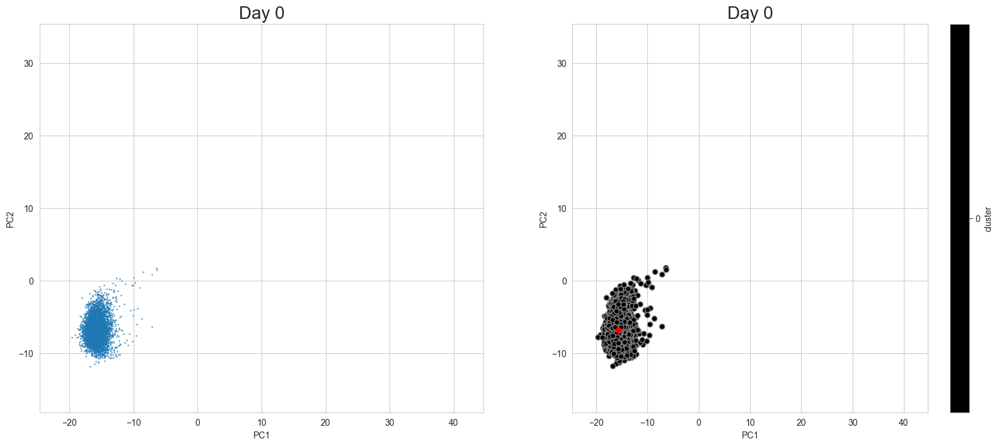

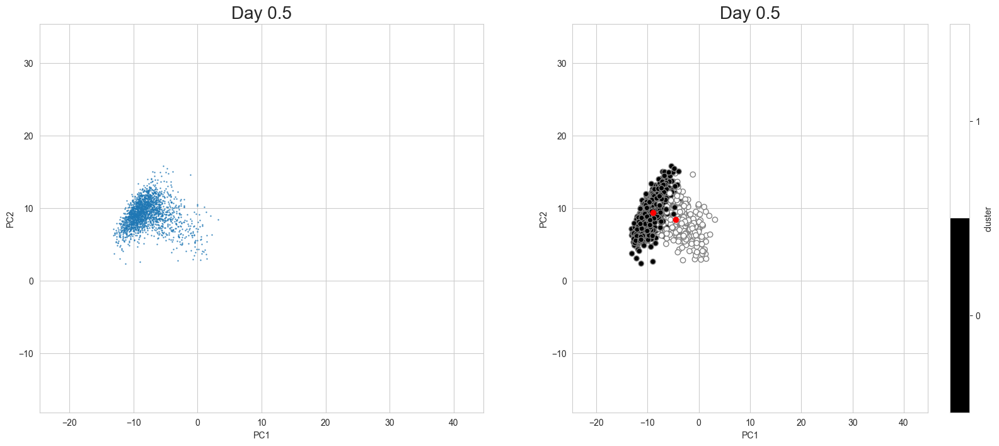

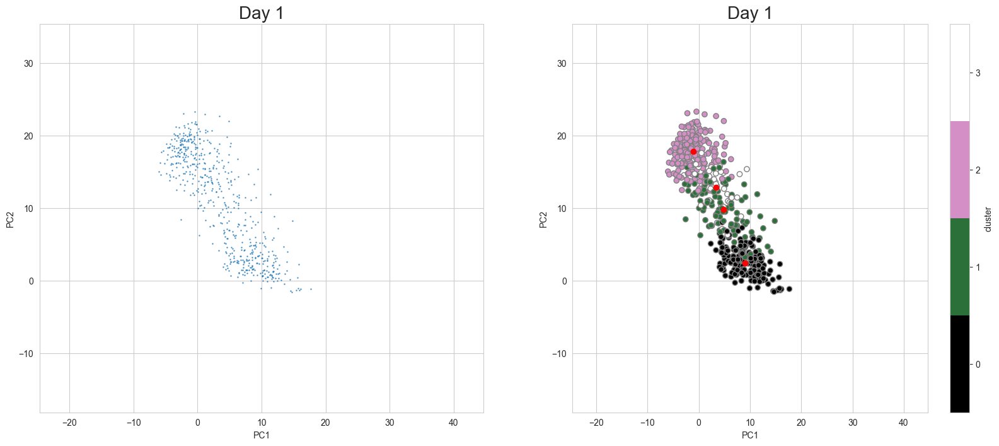

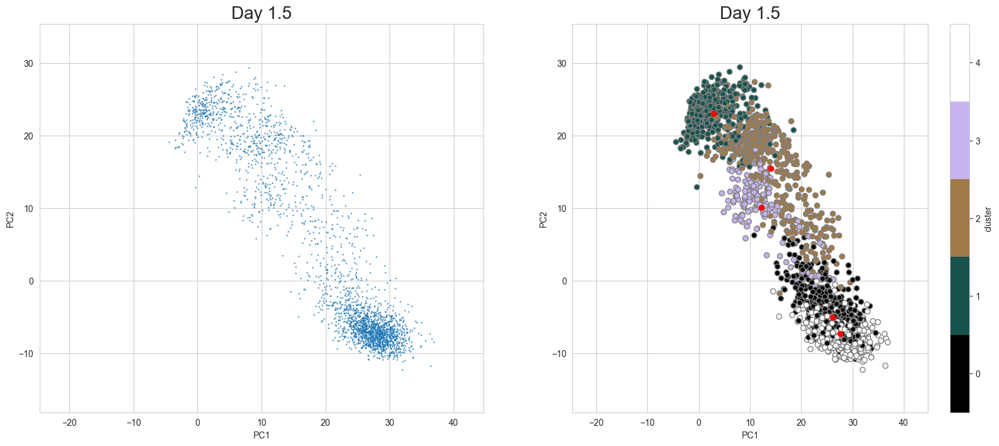

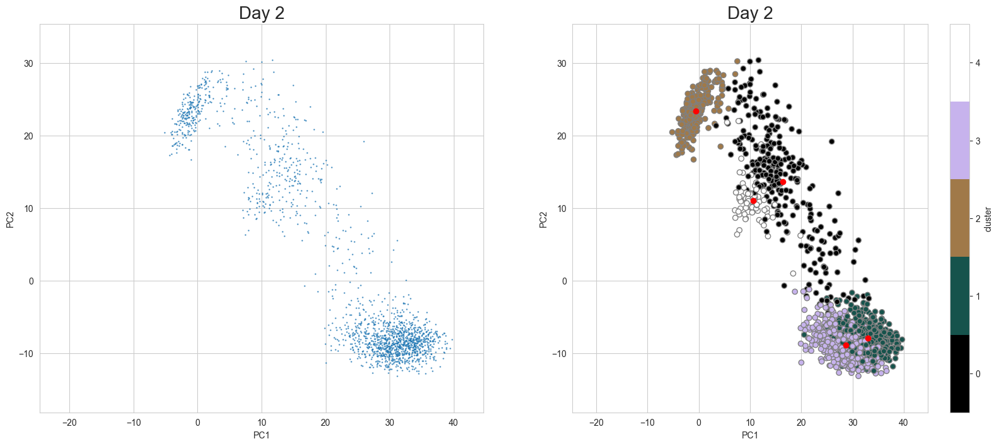

CPU times: total: 39.9 s
Wall time: 24.2 s


In [24]:
%%time

cluster_numbers = [1,2,4,5,5] #各dayのクラスタ数
File_name2 = ['0','0.5','1','1.5','2']
all_days = len(All_Files)
savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/figure_PCA"
gmm_all = []
labels_all = []

if not os.path.exists(savedir):
    os.makedirs(savedir)

# load gmm file if you have gmm_file
gmm_all = shelve.open('gmm_all')
labels_all = shelve.open('label_all')

for i in range(all_days):
    X = pd.read_csv(All_Files[i], index_col=0)
    n_components1 = cluster_numbers[i]
    
    #gmm = gmm_all[File_name2[i]]
    #gmm_labels = labels_all[File_name2[i]]
    
    # estimate gmm if you do not have gmm_file
    gmm = sklearn.mixture.GaussianMixture(n_components1, covariance_type='full',max_iter=2000,n_init=10,random_state=2022)
    gmm.fit(X.values)
    gmm_labels = gmm.predict(X.values)
    
    # plot figure
    plt.figure(figsize=(20,8))
    plt.subplot(1,2,1)
    plot_PCA(df_log_PCA,X)
    plt.title(f'Day {File_name2[i]}', fontsize=20)
    
    plt.subplot(1,2,2)
    for k in range(n_components1):
        plt.plot(gmm.means_[k][0], gmm.means_[k][1], 'ro')
        
    plot_GMM(df_log_PCA,X,gmm_labels,n_components1)
    plt.title(f'Day {File_name2[i]}', fontsize=20)
    plt.savefig('%s/Day%s.png' % (savedir,File_name2[i]),dpi=600)
    plt.show()
    
    # save gmm data if you do not have gmm_file
    gmm_all[File_name2[i]] = gmm
    labels_all[File_name2[i]] = gmm_labels

## UMAP

CPU times: total: 5min 54s
Wall time: 1min 35s


Text(0, 0.5, 'UMAP2')

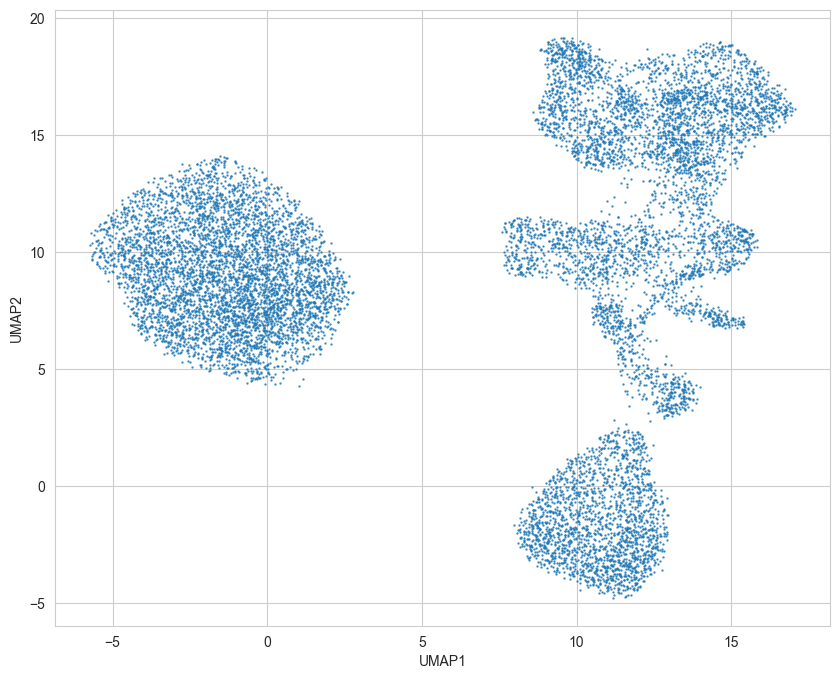

In [25]:
%%time
n_neighbors = 1000
umap_model = umap.UMAP(n_components=2,n_neighbors=n_neighbors,random_state=2022,min_dist=0.8)
umap_coords = umap_model.fit_transform(df_log_PCA.values)
df_log_UMAP = pd.DataFrame(umap_coords, index=df_log.index, columns=['UMAP1','UMAP2'])
plt.figure(figsize=(10, 8))
plt.scatter(umap_coords[:,0], umap_coords[:,1], s=.5, alpha=.8)
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')

In [26]:
savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedataRECODE_withoutMT/logUMAP"
filename = ['D0','D05','D1','D15','D2']
savefile_all_to_each_day(df_log_UMAP,cell_numbers,savedir,filename)
DATA_PATH_UMAP = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedataRECODE_withoutMT/logUMAP/"
All_Files_UMAP = sorted(glob.glob('{}*.csv'.format(DATA_PATH_UMAP)))
print_all_files(All_Files_UMAP)

./usedataSMALL_withoutMT/logUMAP\D0.csv
./usedataSMALL_withoutMT/logUMAP\D05.csv
./usedataSMALL_withoutMT/logUMAP\D1.csv
./usedataSMALL_withoutMT/logUMAP\D15.csv
./usedataSMALL_withoutMT/logUMAP\D2.csv


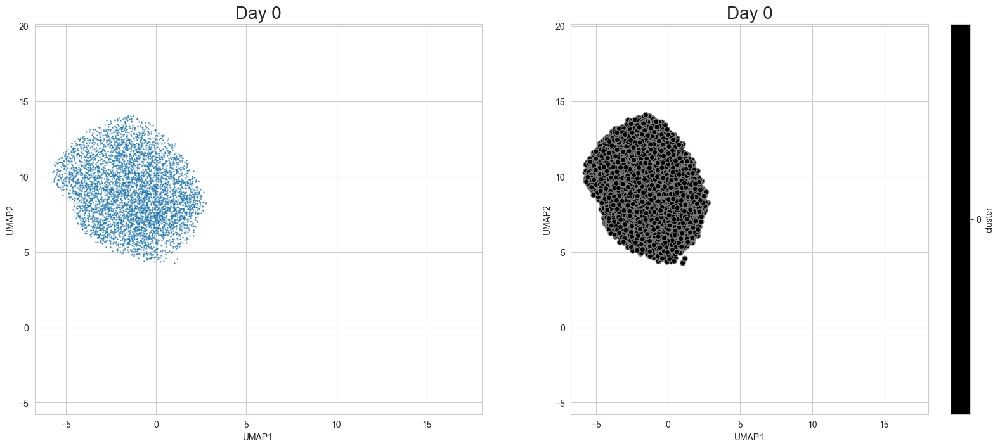

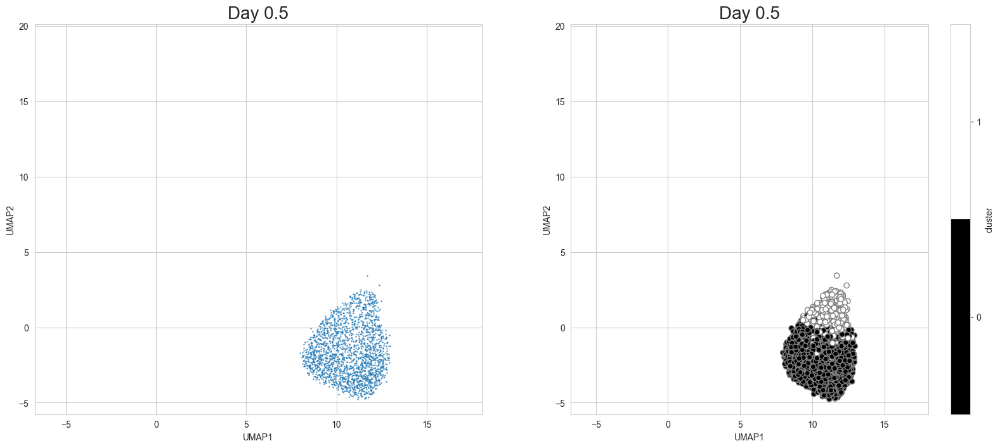

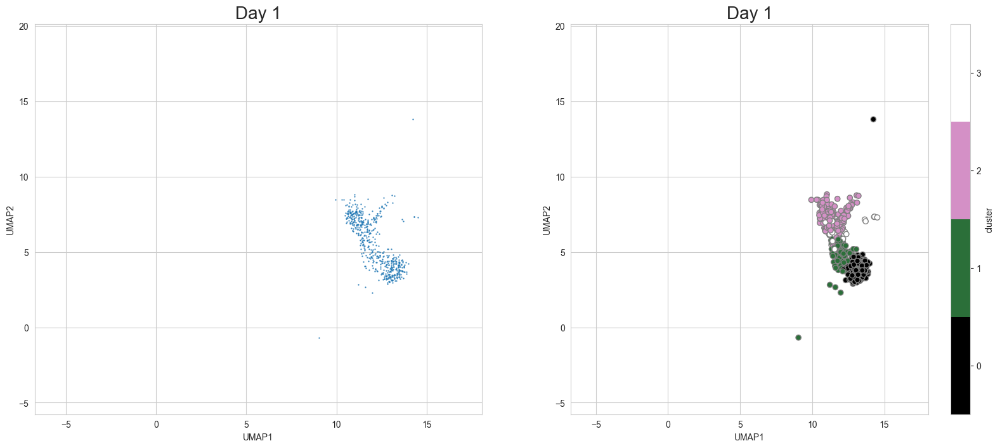

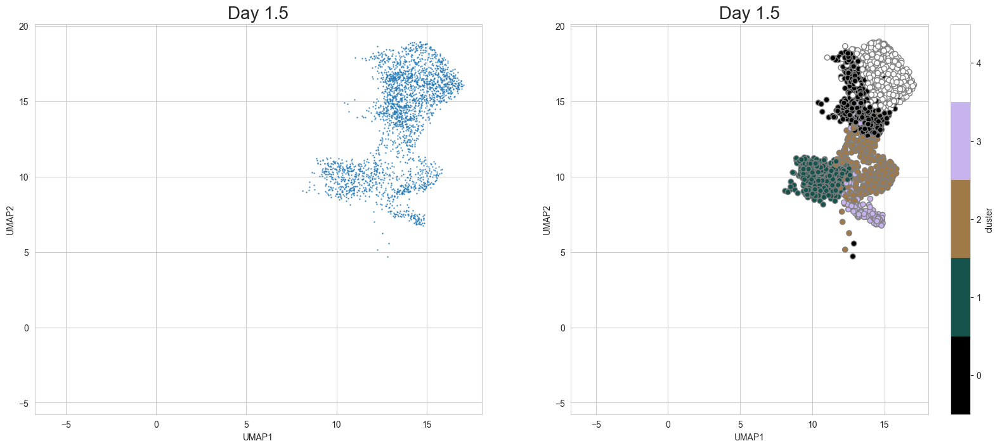

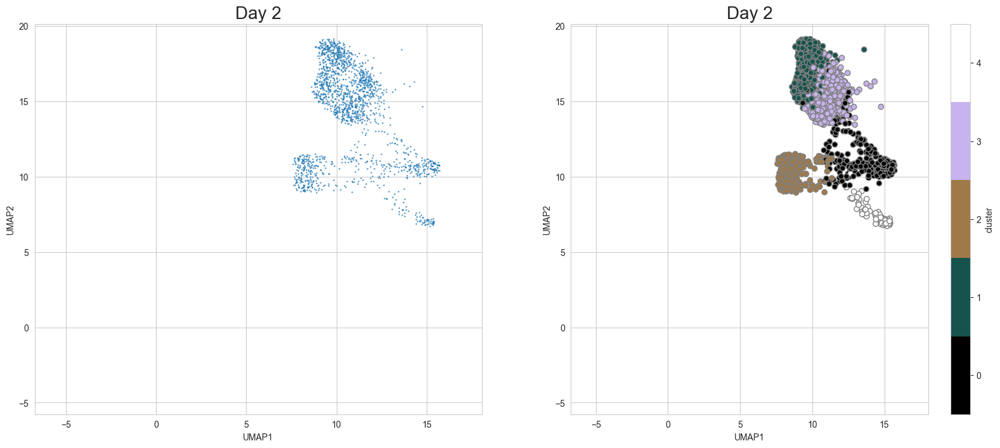

CPU times: total: 16.2 s
Wall time: 17 s


In [27]:
%%time
#UMAP
savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/figure_UMAP"
DATA_PATH = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/usedataRECODE_withoutMT/logPCA/"
All_Files = sorted(glob.glob('{}*.csv'.format(DATA_PATH)))

for i in range(all_days):
    plt.figure(figsize=(20,8))
    plt.subplot(1,2,1)
    X_UMAP = pd.read_csv(All_Files_UMAP[i], index_col=0)
    plot_UMAP(df_log_UMAP,X_UMAP)
    plt.title(f'Day {File_name2[i]}', fontsize=20)
    plt.subplot(1,2,2)
    X = pd.read_csv(All_Files[i], index_col=0)
    n_components1 = cluster_numbers[i]
    gmm = gmm_all[File_name2[i]]
    gmm_labels = labels_all[File_name2[i]]
    plot_GMM_UMAP(df_log_UMAP,X_UMAP,gmm_labels,n_components=1)
    plt.title(f'Day {File_name2[i]}', fontsize=20)
    plt.savefig('%s/Day%s.png' % (savedir,File_name2[i]),dpi=600)
    plt.show()

## 動画（分化の様子？）

In [28]:
%%time
wstar_all = []
wstar_all_normalized = []
means_all = []
means_UMAP_all = []
label_all = []
means_xpos = []
means_ypos = []
means_xpos_UMAP = []
means_ypos_UMAP = []
node_weights = []
node_day = []
ims = []

fig,ax = plt.subplots(figsize=(10,8))
for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    
    # Compute EGW 
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    
    wstar = EGW(np.ravel(pi0),np.ravel(pi1),mu0.reshape(K0,d),mu1.reshape(K1,d),S0.reshape(K0,d,d),S1.reshape(K1,d,d))
    wstar_all.append(wstar)
    wstar_normalized = (wstar.T/gmm1.weights_).T
    wstar_all_normalized.append(wstar_normalized)
    
    node_weights = np.append(node_weights,gmm1.weights_)
    means_all.append(gmm1.means_)
    for s in range(cluster_numbers[i]):
        node_day = np.append(node_day,float(File_name2[i]))
    
    t =  np.linspace(0, 1, 11)
    for j in range(11):
        im = interpolation_contour(df_log_PCA,t[j])
        title = ax.text(0.5, 1.0, f'Day {File_name2[i]}, t = {t[j]:.1f}',
                        ha='center', va='bottom',
                        transform=ax.transAxes, fontsize=20)
        plt.xlabel('PC1')
        plt.ylabel('PC2')
        ims.append(im+[title])

node_weights = np.append(node_weights,gmm2.weights_)

for s in range(cluster_numbers[all_days-1]):
    node_day = np.append(node_day,float(File_name2[all_days-1]))
        
means_all.append(gmm2.means_)
means_xpos = np.array(list(itertools.chain.from_iterable(means_all))).T[0]
means_ypos = np.array(list(itertools.chain.from_iterable(means_all))).T[1]
means_UMAP_all = umap_model.transform(list(itertools.chain.from_iterable(means_all)))
means_xpos_UMAP = means_UMAP_all.T[0]
means_ypos_UMAP = means_UMAP_all.T[1]

anim = animation.ArtistAnimation(fig, ims, interval=100)
plt.close()
HTML(anim.to_jshtml())

#savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output"
#title = "Test_movie_EGOT1"
#anim.save('%s/%s.gif'%(savedir,title),writer=PillowWriter(fps=8),dpi=300)

CPU times: total: 1min 8s
Wall time: 1min 8s


## cell state

### グラフ描画の準備

In [29]:
genes_means_all = []
for i in range(all_days):
    genes_means_all_temp = pca.inverse_transform(means_all[i])
    genes_means_all.append(genes_means_all_temp)
genes_length = len(df.columns)
genes_means_all = list(itertools.chain.from_iterable(list(itertools.chain.from_iterable(genes_means_all))))
genes_value = np.array(genes_means_all).reshape(sum(cluster_numbers),genes_length).tolist()
cluster_all = list_cluster_all(All_Files,File_name2,cluster_numbers)
cluster_all1d = list(itertools.chain.from_iterable(cluster_all))
df_genes = pd.DataFrame(genes_value,index=cluster_all1d, columns=df.columns)
df_genes = df_genes.where(df_genes > 0, 0)
df_graph = df_makegraph(All_Files,cluster_all,wstar_all_normalized,Thr=0.1)

In [30]:
num=5
df_genes_nlargest = df_genes.T.apply(get_genes_nlargest,num=num).T
df_genes_nsmallest = df_genes.T.apply(get_genes_nsmallest,num=num).T
df_genes_nlargest.columns += 1
df_genes_nsmallest.columns += 1
df_upgenes = df_up_regulated_genes(df_genes,df_graph,num=num)
df_downgenes = df_down_regulated_genes(df_genes,df_graph,num=num)

In [31]:
# 転写因子
# df_TFgenes_name = pd.read_csv("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/TF_genes/TFgenes_name.csv", index_col=0)
df_TFgenes_name = pd.read_csv("./TF_genes/TFgenes_name.csv", index_col=0)
df_TFgenes = df_genes.loc[:, df_genes.columns.isin(df_TFgenes_name.columns)]
df_TFgenes_nlargest = df_TFgenes.T.apply(get_genes_nlargest,num=num).T
df_TFgenes_nsmallest = df_TFgenes.T.apply(get_genes_nsmallest,num=num).T
df_TFgenes_nlargest.columns += 1
df_TFgenes_nsmallest.columns += 1
df_TFupgenes = df_up_regulated_genes(df_TFgenes,df_graph,num=num)
df_TFdowngenes = df_down_regulated_genes(df_TFgenes,df_graph,num=num)

### PCA版

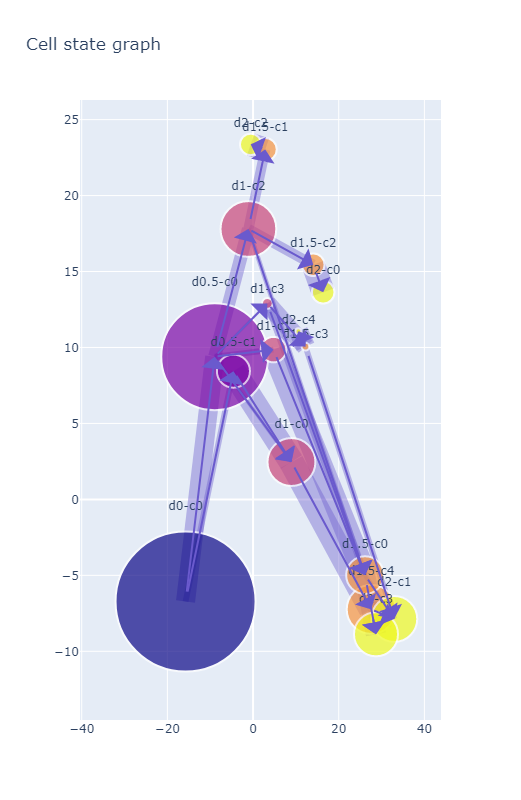

In [32]:
# cell state graph on PCA
G = nx.from_pandas_edgelist(df_graph, source='source', target='target',edge_attr=['edge_weights'],create_using=nx.DiGraph)
pos = {}
df_nodeweights_and_pos = df_makenodeweights_and_pos(node_weights,cluster_all1d,means_xpos,means_ypos,node_day)
for nodename,xpos,ypos,day in zip(df_nodeweights_and_pos.index,df_nodeweights_and_pos['xpos'],df_nodeweights_and_pos['ypos'],df_nodeweights_and_pos['node_days']):
    G.add_node(nodename, weight=df_nodeweights_and_pos['node_weights'][nodename])
    G.add_node(nodename, day=df_nodeweights_and_pos['node_days'][nodename])
    pos[nodename] = (xpos,ypos)

cell_state_graph(G,pos,df_TFgenes_nlargest,df_TFgenes_nsmallest,df_TFupgenes,df_TFdowngenes)

### UMAP版

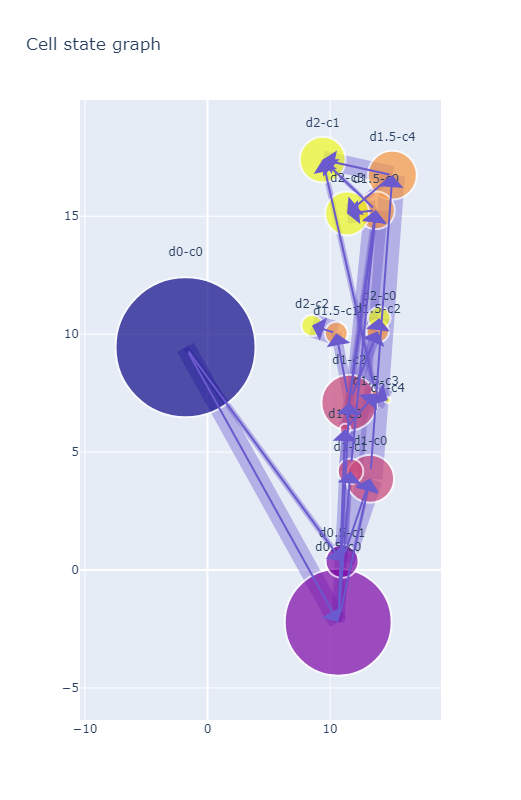

In [33]:
# cell state graph on UMAP
df_UMAPgraph = df_makegraph(All_Files,cluster_all,wstar_all_normalized,Thr=0.1)
G_UMAP = nx.from_pandas_edgelist(df_UMAPgraph, source='source', target='target',edge_attr=['edge_weights'],create_using=nx.DiGraph)
pos_UMAP = {}
df_nodeweights_and_pos_UMAP = df_makenodeweights_and_pos(node_weights,cluster_all1d,means_xpos_UMAP,means_ypos_UMAP,node_day)
for nodename,xpos,ypos,day in zip(df_nodeweights_and_pos_UMAP.index,df_nodeweights_and_pos_UMAP['xpos'],df_nodeweights_and_pos_UMAP['ypos'],df_nodeweights_and_pos_UMAP['node_days']):
    G_UMAP.add_node(nodename, weight=df_nodeweights_and_pos_UMAP['node_weights'][nodename])
    G_UMAP.add_node(nodename, day=df_nodeweights_and_pos_UMAP['node_days'][nodename])
    pos_UMAP[nodename] = (xpos,ypos)

cell_state_graph(G_UMAP,pos_UMAP,df_TFgenes_nlargest,df_TFgenes_nsmallest,df_TFupgenes,df_TFdowngenes)

## fold-change

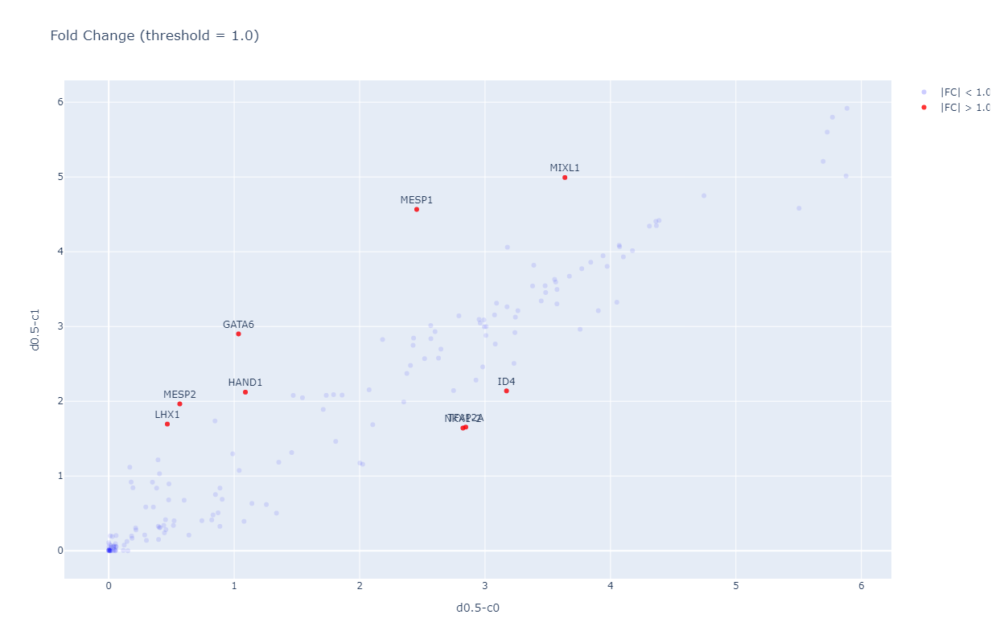

In [34]:
# Fold Change
plot_fold_change(df_TFgenes,'d0.5-c0','d0.5-c1',threshold=1.0)

## pathway

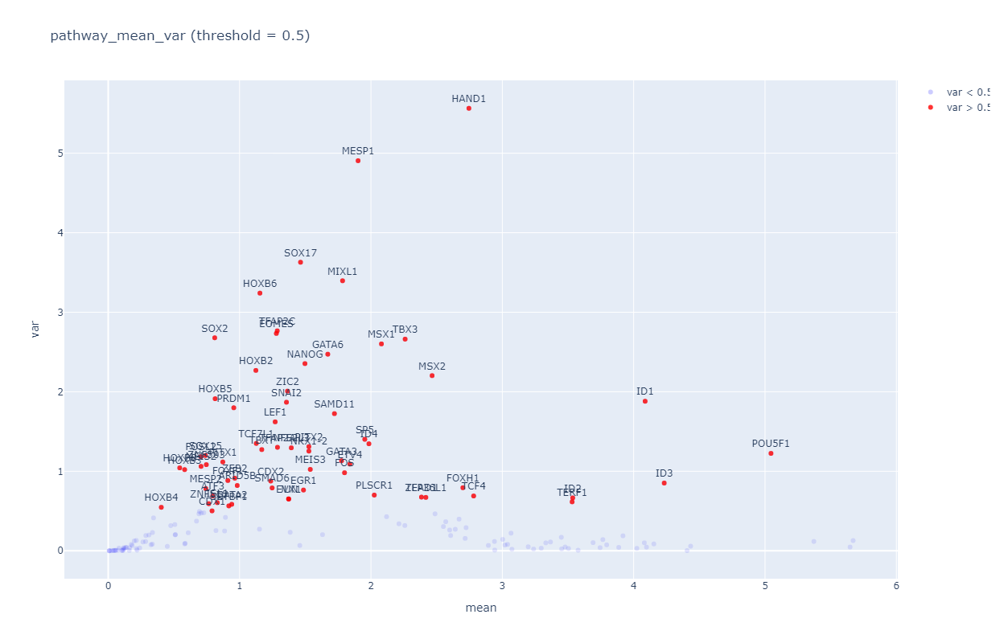

In [35]:
# クラスタを指定することでその経路における遺伝子発現パターンを見ることができる
pathway_name = ['d0-c0','d0.5-c1','d1-c1','d1.5-c4','d2-c2']
df_pathway_genes = df_TFgenes.T[pathway_name].T
plot_pathway_mean_var(df_pathway_genes,threshold=0.5)

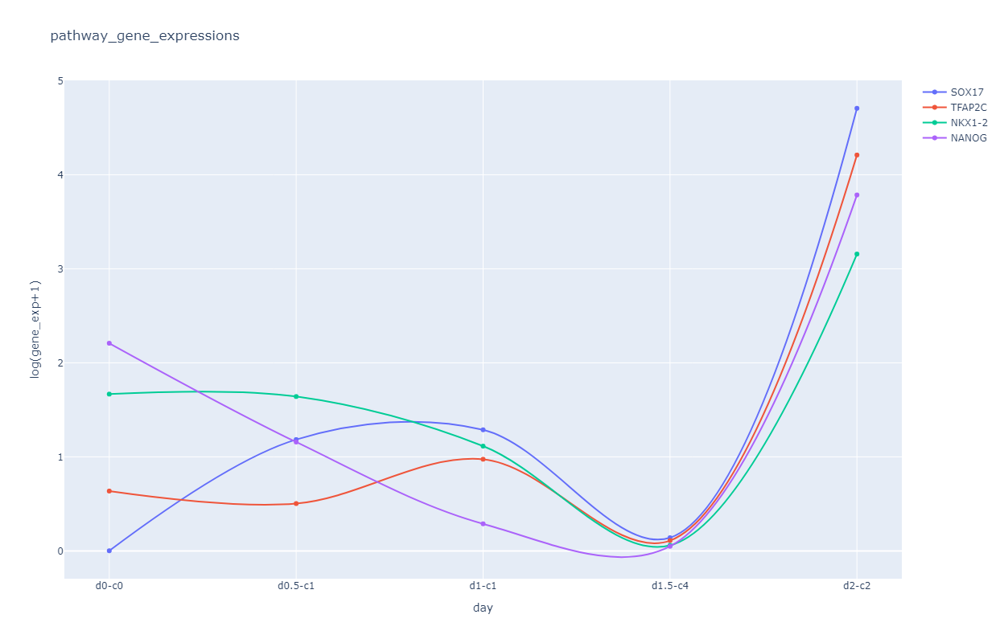

In [36]:
#selected_genes = ['HAND1','FOXF1','MESP1','EOMES']
selected_genes = ['NANOG','SOX17','TFAP2C','NKX1-2']
plot_pathway_gene_expressions(df_pathway_genes,selected_genes)

## 単一遺伝子の特徴量のプロット

### PCA版

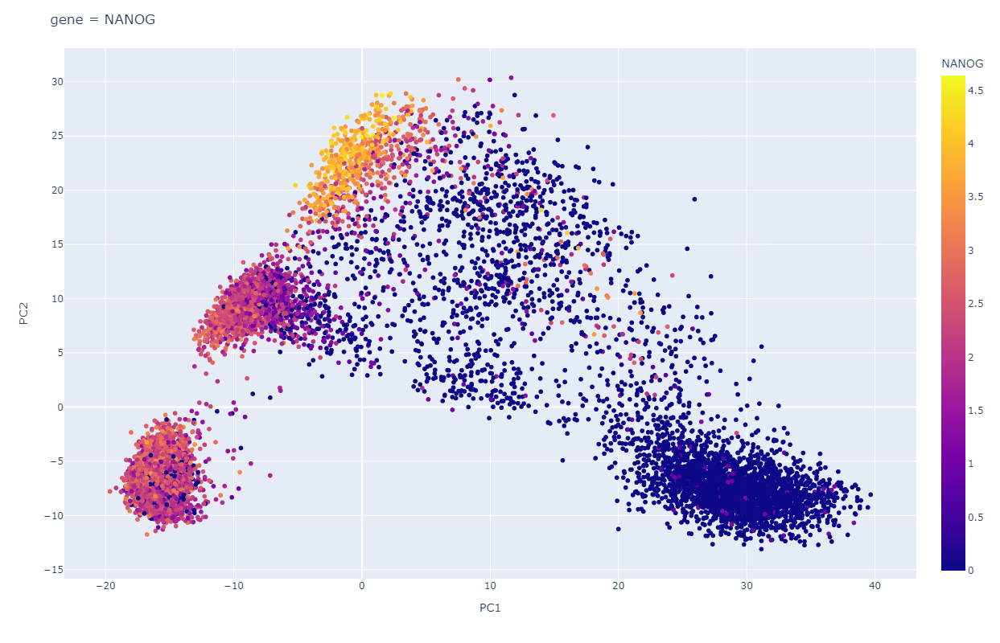

In [37]:
gene_name = 'NANOG'
df_for_gene_plot = df_log.copy()
df_for_gene_plot['PC1'] = df_log_PCA['PC1']
df_for_gene_plot['PC2'] = df_log_PCA['PC2']
df_for_gene_plot['PC3'] = df_log_PCA['PC3']
fig = px.scatter(df_for_gene_plot,x='PC1',y='PC2',color=gene_name,hover_name=df_for_gene_plot.index,width=1000,height=800)
fig.update_layout(title=f'gene = {gene_name}')
fig.show()

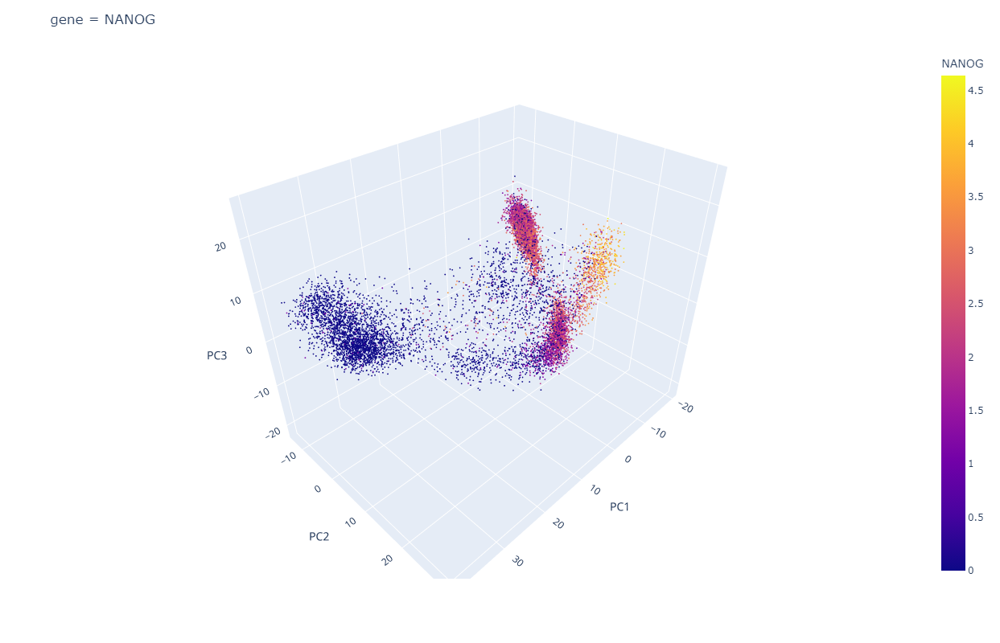

In [38]:
#3d plot
fig = px.scatter_3d(df_for_gene_plot,x='PC1',y='PC2',z='PC3',color=gene_name,hover_name=df_for_gene_plot.index,width=1000,height=800)
fig.update_traces(marker_size = 1)
fig.update_layout(title=f'gene = {gene_name}')
fig.show()

### UMAP版

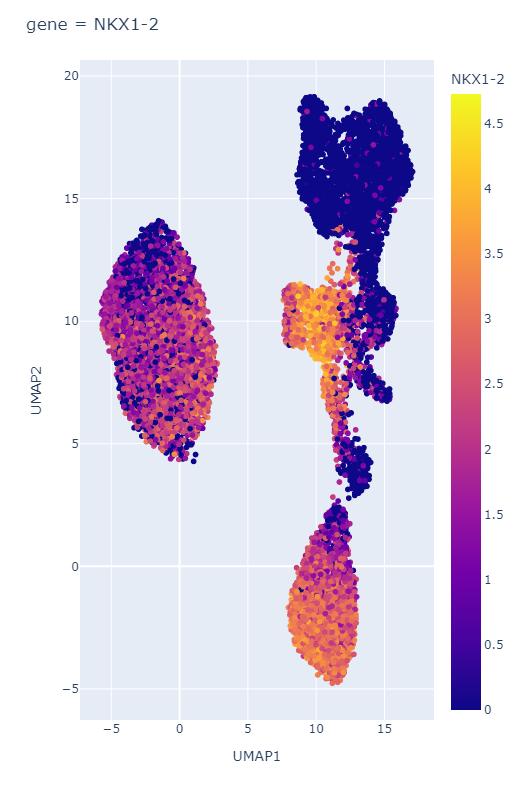

In [39]:
# umap plot
gene_name = 'NKX1-2'
df_for_gene_plot_UMAP = df_log.copy()
df_for_gene_plot_UMAP['UMAP1'] = df_log_UMAP['UMAP1']
df_for_gene_plot_UMAP['UMAP2'] = df_log_UMAP['UMAP2']
fig = px.scatter(df_for_gene_plot_UMAP,x='UMAP1',y='UMAP2',color=gene_name,hover_name=df_for_gene_plot_UMAP.index,width=1000,height=800)
fig.update_layout(title=f'gene = {gene_name}')
fig.show()

## interpolation

### 精度チェック

In [2]:
%%time
df1 = pd.read_csv(All_Files[1], index_col=0)
df2 = pd.read_csv(All_Files[3], index_col=0)
n_components1 = cluster_numbers[1]
n_components2 = cluster_numbers[3]
n_samples = 2000
gmm1 = gmm_all[File_name2[1]]
gmm2 = gmm_all[File_name2[3]]
df_interpolation = df_make_interpolation_data(gmm1,gmm2,df1,df2,n_samples,0.5)

NameError: name 'pd' is not defined

Text(0.5, 1.0, 'true and interpolation distributions')

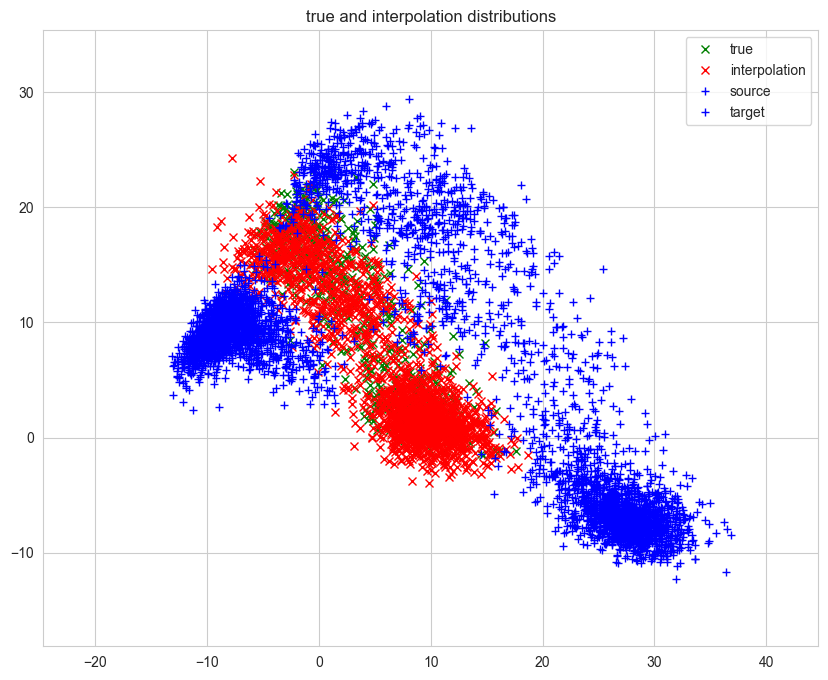

In [41]:
df_true = pd.read_csv(All_Files[2], index_col=0)

fig = plt.figure(figsize=(10,8))
plt.plot(df_true['PC1'].values, df_true['PC2'].values, 'xg', label='true')
plt.plot(df_interpolation['PC1'].values, df_interpolation['PC2'].values, 'xr', label='interpolation')
plt.plot(df1['PC1'].values, df1['PC2'].values, '+b', label='source')
plt.plot(df2['PC1'].values, df2['PC2'].values, '+b', label='target')
plt.xlim(np.min(df_log_PCA['PC1'].values)-5, np.max(df_log_PCA['PC1'].values)+5)
plt.ylim(np.min(df_log_PCA['PC2'].values)-5, np.max(df_log_PCA['PC2'].values)+5)
plt.legend(loc=0)
plt.title('true and interpolation distributions')
#plt.savefig('compare_true_interpolate_pointdata t=0.5, n=2000.pdf')

### 動画（PCA版）

In [42]:
%%time
target_gene = 'NKX1-2'
n_samples = 5000
ims = []

fig,ax = plt.subplots(figsize=(10,8))

for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]
    
    t =  np.linspace(0, 1, 11)
    for j in range(11):
        X_interpolation=interpolation_data(n_samples,t[j])
        X_genes_interpolation = pca.inverse_transform(X_interpolation)
        df_genes_interpolation = pd.DataFrame(X_genes_interpolation, columns=df.columns)
        im = plt.scatter(X_interpolation[:, 0], X_interpolation[:, 1], c=df_genes_interpolation[target_gene].values,s=.5, alpha=.8,cmap='rainbow')
        plt.xlabel('PC1')
        plt.ylabel('PC2')
        plt.xlim(np.min(df_log_PCA['PC1'].values)-5, np.max(df_log_PCA['PC1'].values)+5)
        plt.ylim(np.min(df_log_PCA['PC2'].values)-5, np.max(df_log_PCA['PC2'].values)+5)
        plt.clim(np.min(df_for_gene_plot[target_gene].values),np.max(df_for_gene_plot[target_gene].values))
        if i==0 and j == 0:
            plt.colorbar()
        title = ax.text(0.5, 1.0, f'Day {File_name2[i]}, t = {t[j]:.1f}, gene = {target_gene}',
                        ha='center', va='bottom',
                        transform=ax.transAxes, fontsize=20)
        ims.append([im]+[title])

anim_gene = animation.ArtistAnimation(fig, ims, interval=100)
plt.close()
HTML(anim_gene.to_jshtml())

#savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/genes_movie"
#title = f"gene = {target_gene}"
#anim_gene.save('%s/%s.gif'%(savedir,title),writer=PillowWriter(fps=8),dpi=300)

CPU times: total: 20.2 s
Wall time: 16.4 s


### 動画（UMAP版）

KeyboardInterrupt: 

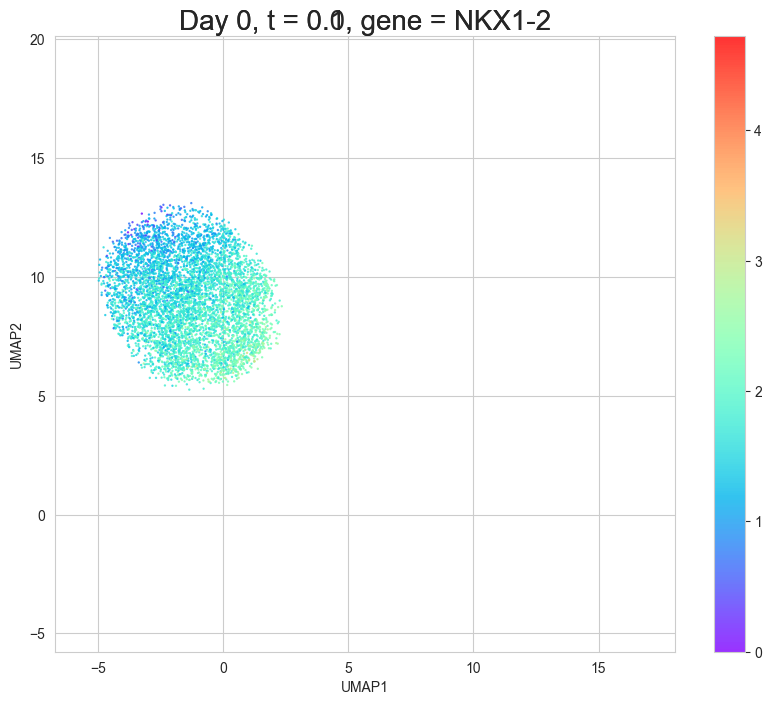

In [43]:
%%time
#umap interpolation movie
#umapでgene expression movieを作るのは計算コストがかなり重いことに注意 1~2時間かかる
target_gene = 'NKX1-2'
n_samples = 3000
ims = []

fig,ax = plt.subplots(figsize=(10,8))

for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]
    
    t =  np.linspace(0, 1, 11)
    for j in range(11):
        X_interpolation = interpolation_data(n_samples,t[j])
        X_genes_interpolation = pca.inverse_transform(X_interpolation)
        df_genes_interpolation = pd.DataFrame(X_genes_interpolation, columns=df.columns)
        X_interpolation_UMAP = umap_model.transform(X_interpolation)
        im = plt.scatter(X_interpolation_UMAP[:, 0], X_interpolation_UMAP[:, 1], c=df_genes_interpolation[target_gene].values,s=.5, alpha=.8,cmap='rainbow')
        plt.xlabel('UMAP1')
        plt.ylabel('UMAP2')
        plt.xlim(np.min(df_log_UMAP['UMAP1'].values)-1, np.max(df_log_UMAP['UMAP1'].values)+1)
        plt.ylim(np.min(df_log_UMAP['UMAP2'].values)-1, np.max(df_log_UMAP['UMAP2'].values)+1)
        plt.clim(np.min(df_for_gene_plot_UMAP[target_gene].values),np.max(df_for_gene_plot_UMAP[target_gene].values))
        if i==0 and j == 0:
            plt.colorbar()
        title = ax.text(0.5, 1.0, f'Day {File_name2[i]}, t = {t[j]:.1f}, gene = {target_gene}',
                        ha='center', va='bottom',
                        transform=ax.transAxes, fontsize=20)
        ims.append([im]+[title])

anim_gene = animation.ArtistAnimation(fig, ims, interval=150)
plt.close()
HTML(anim_gene.to_jshtml())

#savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/genes_movie/UMAP"
#title = f"gene = {target_gene}"
#anim_gene.save('%s/%s.gif'%(savedir,title),writer=PillowWriter(fps=8),dpi=300)

## cell velocity

### PCA版

In [ ]:
%%time
# Cell velocity
x_coordinate = []
y_coordinate = []
x_velocity = []
y_velocity = []
speed = []
df_x = pd.DataFrame(columns=df_log.columns)
df_velocity = pd.DataFrame(columns=df_log.columns)

for i in range(all_days-1):    
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]
    
    velo_temp = compute_cell_velocity(gmm1,gmm2,df1)
    U = velo_temp[:,0]
    V = velo_temp[:,1]
    
    x_coordinate = np.append(x_coordinate,df1['PC1'].values)
    y_coordinate = np.append(y_coordinate,df1['PC2'].values)
    x_velocity = np.append(x_velocity,U)
    y_velocity = np.append(y_velocity,V)
    speed = np.append(speed,np.sqrt(U**2+V**2))
    
    xx = pca.inverse_transform(df1.values)
    df_xtemp = pd.DataFrame(xx, columns=df_log.columns)
    df_x = pd.concat([df_x, df_xtemp], axis=0, join='inner')
    df_x = df_x.where(df_x > 0, 0)
    df_TFx = df_x.loc[:, df_x.columns.isin(df_TFgenes_name.columns)]
    df_TFx = df_TFx.where(df_TFx > 0, 0)
    
    velo_x = pca.inverse_transform(velo_temp)
    dfvelo_x = pd.DataFrame(velo_x, columns=df_log.columns)
    df_velocity = pd.concat([df_velocity, dfvelo_x], axis=0, join='inner')
    df_TFvelocity = df_velocity.loc[:, df_velocity.columns.isin(df_TFgenes_name.columns)]

In [ ]:
cell_velocity_plot(x_coordinate,y_coordinate,x_velocity,y_velocity,speed,cmap='rainbow',mode='PCA')

### UMAP版

In [46]:
%%time
# Cell velocity on UMAP
x_coordinate_UMAP = []
y_coordinate_UMAP = []
x_velocity_UMAP = []
y_velocity_UMAP = []
speed_UMAP = []

for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]
    
    velo_temp = compute_cell_velocity(gmm1,gmm2,df1)
    velo_temp_UMAP = umap_model.transform(velo_temp)
    U = velo_temp[:,0]
    V = velo_temp[:,1]
    U_UMAP = velo_temp_UMAP[:,0]
    V_UMAP = velo_temp_UMAP[:,1]
    
    coordinate_UMAP = umap_model.transform(df1.values)
    x_coordinate_UMAP = np.append(x_coordinate_UMAP,coordinate_UMAP[:,0])
    y_coordinate_UMAP = np.append(y_coordinate_UMAP,coordinate_UMAP[:,1])
    x_velocity_UMAP = np.append(x_velocity_UMAP,U_UMAP)
    y_velocity_UMAP = np.append(y_velocity_UMAP,V_UMAP)
    speed_UMAP = np.append(speed_UMAP,np.sqrt(U_UMAP**2+V_UMAP**2))

KeyboardInterrupt: 

In [47]:
cell_velocity_plot(x_coordinate_UMAP,y_coordinate_UMAP,x_velocity_UMAP,y_velocity_UMAP,speed_UMAP,cmap='rainbow',mode='UMAP')

TypeError: unsupported operand type(s) for /: 'list' and 'list'

<Figure size 1000x800 with 0 Axes>

## Others

In [ ]:
# Interpolation cell velocity 
numx = numy = 300
xmin = np.min(df_log_PCA['PC1'].values)-5
xmax = np.max(df_log_PCA['PC1'].values)+5
ymin = np.min(df_log_PCA['PC2'].values)-5
ymax = np.max(df_log_PCA['PC2'].values)+5

x = np.linspace(xmin, xmax, numx)
y = np.linspace(ymin, ymax, numy)
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T

points = np.transpose(np.vstack((x_coordinate, y_coordinate)))
strm_x_velocity = interpolate.griddata(points, x_velocity, (X, Y),method='linear',fill_value=0)
strm_y_velocity = interpolate.griddata(points, y_velocity, (X, Y),method='linear',fill_value=0)
strm_speed = np.sqrt(strm_x_velocity**2+strm_y_velocity**2)

plt.figure(figsize=(10, 8))
strm = plt.streamplot(X,Y,strm_x_velocity,strm_y_velocity,density=3.0,color=strm_speed,cmap='rainbow')
plt.scatter(x_coordinate, y_coordinate, c='gray', s=6, alpha=.3)
plt.colorbar(strm.lines)
#plt.savefig("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/RNAvelocitylike.png",dpi=300)
plt.show()

In [ ]:
%%time

#in silico perturbation   
x_velocity_KO = []
y_velocity_KO = []
speed_KO = []

for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]

    velo_temp = compute_cell_velocity(gmm1,gmm2,df1)
    
    xx = pca.inverse_transform(df1.values)
    df_xtemp = pd.DataFrame(xx, columns=df_log.columns)
    df_TFxtemp = df_xtemp.loc[:, df_xtemp.columns.isin(df_TFgenes_name.columns)]
    
    velo_x = pca.inverse_transform(velo_temp)
    dfvelo_x = pd.DataFrame(velo_x, columns=df_log.columns)
    df_TFvelo_x = dfvelo_x.loc[:, dfvelo_x.columns.isin(df_TFgenes_name.columns)]
    
    alphas_cv = np.logspace(-2, 2, num=20)
    reg_cv = linear_model.RidgeCV(alphas=alphas_cv, cv=3,fit_intercept=False)
    reg_cv.fit(df_TFxtemp,df_TFvelo_x)
    print("alpha = ", reg_cv.alpha_)
    GRN = linear_model.Ridge(alpha=reg_cv.alpha_,fit_intercept=False)
    GRN.fit(df_TFxtemp,df_TFvelo_x)
    df_GRN = pd.DataFrame(GRN.coef_, index=df_TFxtemp.columns, columns=df_TFxtemp.columns)
    genes = ['TFAP2C','SOX17','PRDM1','NKX1-2']
    GRNgraph = make_GRN(df_GRN[genes].loc[genes],threshold=0.1)
    display(Image(GRNgraph.create(format='png')))
    
    # insilico perturbation
    #KOgenes = ['TFAP2C','SOX17','PRDM1','NKX1-2']
    #df_A_KO = df_GRN.copy()
    #df_A_KO.loc[KOgenes] = 0
    #vgenes_KO = np.dot(df_A_KO.values,df_xtemp.values.T).T
    #vgenes_KO_PCA = pca.transform(vgenes_KO)
    #U_KO = vgenes_KO_PCA[:,0]
    #V_KO = vgenes_KO_PCA[:,1]
    #x_velocity_KO = np.append(x_velocity_KO,U_KO)
    #y_velocity_KO = np.append(y_velocity_KO,V_KO)
    #speed_KO = np.append(speed_KO,np.sqrt(U_KO**2+V_KO**2))

In [ ]:
#cell_velocity_plot(x_coordinate,y_coordinate,x_velocity_KO,y_velocity_KO,speed_KO,cmap='rainbow',mode='PCA')

In [ ]:
%%time
# Waddington landscapeの再実装 点群でのWaddington landscape

# -Laplacian phi = div f　をグラフ上で解く
# Laplacianは組み合わせ論的Laplacianで，　div fは具体的に計算できる

F_all = []
df_x_PCA2dim = pd.DataFrame(columns=['PC1','PC2'])

for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = cluster_numbers[i]
    n_components2 = cluster_numbers[i+1]
    gmm1 = gmm_all[File_name2[i]]
    gmm2 = gmm_all[File_name2[i+1]]
    d  = n_components 
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]
    
    df1_2dim = df1.loc[:,['PC1','PC2']].copy()
    # Waddington potential
    B:float = 0
    F:float = 0
    for i in range(K0):
        B = B + np.nan_to_num(np.dot(np.linalg.pinv(S0)[i,:,:],(df1.values-mu0[i,:]).T)*pi0[i]*sps.multivariate_normal.pdf(df1.values,mean=mu0[i,:],cov=S0[i,:,:])/densite_theorique2d(mu0,S0,pi0,df1.values))
    for k in range(K0):
        A = np.dot(np.linalg.pinv(S0)[k,:,:],(df1.values-mu0[k,:]).T)
        I1 = -A + B
        #I1 = I1[0:2,:]
        for l in range(K1):
            P = wstar[k,l]*sps.multivariate_normal.pdf(df1.values,mean=mu0[k,:],cov=S0[k,:,:])/densite_theorique2d(mu0,S0,pi0,df1.values).T
            P = np.nan_to_num(P)
            Tmap = GaussianMap(mu0[k,:],mu1[l,:],S0[k,:,:],S1[l,:,:],df1.values).T
            Tmap = Tmap.real
            #Tmap = Tmap[0:2,:]
            I2 = np.nan_to_num(np.trace(np.linalg.pinv(S0[k,:,:])@spl.sqrtm(S0[k,:,:]@S1[l,:,:])))
            I2 = I2.real
            F = F + np.sum(np.dot(I1,Tmap.T))*P + I2*P
    F = F - d
    F_all = np.append(F_all,F)
    df_x_PCA2dim = pd.concat([df_x_PCA2dim, df1_2dim], axis=0, join='inner')
    
knn = kneighbors_graph(X=df_x_PCA2dim.values,n_neighbors=100,mode='distance',metric='euclidean')
# compute kernel
sim = sparse.csr_matrix(knn.shape)
nonzero = knn.nonzero()
sig = 10
sim[nonzero] = np.exp(-np.array(knn[nonzero])**2/sig**2)
sim = (sim+sim.T)/2
deg = sim.sum(axis=1)
n = df_x_PCA2dim.values.shape[0]
dia = np.diag(np.array(deg).reshape(n,))
lap = dia - sim
lap = np.array(lap)
Wpotential = np.dot(np.linalg.pinv(lap),F_all.T)

Wpotential = scipy.stats.zscore(Wpotential)

In [ ]:
#potential 3d plot
df_potential = df_x_PCA2dim.copy()
df_potential['potential'] = Wpotential
fig = px.scatter_3d(df_potential,x='PC1',y='PC2',z='potential',hover_name=df_potential.index,width=1000,height=800)
fig.update_traces(marker_size = 1)
fig.update_layout(title='Waddington potential')
fig.show()

In [ ]:
# potential plot color: gene expression
gene_name = 'NKX1-2'
df_potential_gene_plot = df_log.copy()
df_potential_gene_plot['PC1'] = df_potential['PC1']
df_potential_gene_plot['PC2'] = df_potential['PC2']
df_potential_gene_plot['potential'] = df_potential['potential']
fig = px.scatter_3d(df_potential_gene_plot,x='PC1',y='PC2',z='potential',color=gene_name,hover_name=df_potential_gene_plot.index,width=1000,height=800)
fig.update_traces(marker_size = 1)
fig.update_layout(title=f'Waddington potential, gene = {gene_name}')
fig.show()